In [1]:
# Lo primero que hacemos es importar todas las librerias necesarias.
#importamos librerias para tratamiento de datos
import numpy as np
import pandas as pd
import re
import math as mat

#importamos librerias la visualizacion de datos
import matplotlib.pyplot as plt
import seaborn as sns
import os
%matplotlib inline

In [2]:
# Abrimos el dataset y hacemos un chequeo para saber cantidad de registros y miramos la composición del mismo, para ello vamos a seleccionar una muestra de datos.
filename = "../dataset/properati.csv"
data = pd.read_csv(filename, encoding='Latin1', sep=",")
display(data.sample(n=6))
print(f"(Cantidad de Filas, Cantidad de columnas) -> {data.shape}")

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
25700,25700,sell,apartment,Boedo,|Argentina|Capital Federal|Boedo|,Argentina,Capital Federal,3436003.0,NaN,NaN,...,35.0,6731.428571,6731.428571,NaN,1.0,NaN,http://www.properati.com.ar/17qb6_venta_depart...,VX11- MUY BUENA OPORTUNIDAD DE INVERTIR EN LAD...,VX11- MUY BUENA OPORTUNIDAD DE INVERTIR EN LAD...,https://thumbs4.properati.com/9/i1NKXK7ar7mhV7...
8199,8199,sell,apartment,Canning,|Argentina|Bs.As. G.B.A. Zona Sur|Esteban Eche...,Argentina,Bs.As. G.B.A. Zona Sur,3435719.0,"-34.8839343,-58.5077452",-34.883934,...,51.0,NaN,2549.019608,NaN,NaN,NaN,http://www.properati.com.ar/1605o_venta_depart...,CODIGO: 3407-ara58 ubicado en: JosÃ© Champagna...,Departamento 2 ambientes en complejo Espacio l...,https://thumbs4.properati.com/0/VCzMtw0FUjDmbs...
105146,105146,sell,house,Punilla,|Argentina|CÃ³rdoba|Punilla|,Argentina,CÃ³rdoba,3839996.0,NaN,NaN,...,180.0,1166.666667,1166.666667,NaN,NaN,NaN,http://www.properati.com.ar/1bu80_venta_casa_p...,"Oportunidad, Carlos Paz. Vendo casa ubicada en...",Casa - Villa Carlos Paz,https://thumbs4.properati.com/4/FSrsQjsVGzdCji...
109278,109278,sell,apartment,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,NaN,NaN,...,53.0,NaN,NaN,NaN,NaN,NaN,http://www.properati.com.ar/1c1ze_venta_depart...,CARACTERÃSTICAS Departamento al contra frente...,Departamento en Centro,https://thumbs4.properati.com/2/WaRL_dpmVhe_Xz...
111146,111146,sell,apartment,Rosario,|Argentina|Santa Fe|Rosario|,Argentina,Santa Fe,3838574.0,"-32.9267724,-60.7503879",-32.926772,...,93.0,1685.958033,39435.483871,NaN,4.0,NaN,http://www.properati.com.ar/1c5aq_venta_depart...,CONDOMINIOS TERRAZAS AL GREENEVA PERÃN 8625 (...,Emprendimiento Condominios Terrazas al Green,https://thumbs4.properati.com/0/ZDJGGoud3-ZIC6...
89182,89182,sell,apartment,NuÃ±ez,|Argentina|Capital Federal|NuÃ±ez|,Argentina,Capital Federal,3430348.0,"-34.5474970262,-58.4695138944",-34.547497,...,28.0,3064.516129,3392.857143,NaN,NaN,1450.0,http://www.properati.com.ar/1b8bw_venta_depart...,"Departamento en venta, monoambiente al contraf...",Departamento apto credito,https://thumbs4.properati.com/0/U5dxgvdq-LDKhF...


(Cantidad de Filas, Cantidad de columnas) -> (121220, 26)


## ANALISIS DE COLUMNAS 
completar análisis de columnas: que columnas hay y que significan cada una.


## 13. COLUMNA PRICE APROX LOCAL CURRENCY

In [3]:
# Columna price_aprox_local_currency: revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.price_aprox_local_currency.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.price_aprox_local_currency.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['price_aprox_local_currency']).size().reset_index(name='count'))

Cantidad de registros con NaN: 20410
Porcentaje de registros con NaN: 16.837155584886982
Contamos cantidad de registros unicos:
       price_aprox_local_currency  count
0                    0.000000e+00      1
1                    8.234017e+04      1
2                    8.738350e+04      1
3                    8.822250e+04      2
4                    8.906114e+04      5
...                           ...    ...
10359                2.823120e+08      1
10360                3.440678e+08      1
10361                4.054773e+08      1
10362                4.411125e+08      1
10363                8.212711e+08      1

[10364 rows x 2 columns]


<AxesSubplot:xlabel='property_type'>

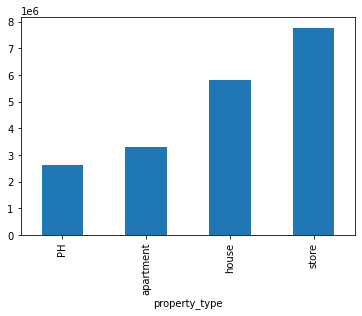

In [4]:
#graficamos el dato por tipo de propiedad con el fin de observar los rangos de precios. Sin embargo vemos que hay unos valores muy altos lo que eleva la dimensión del eje y a numeros exponenciales.
data.groupby('property_type')['price_aprox_local_currency'].mean().plot.bar()

In [5]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos con 
# un apartamento ubicado en la latitul -34.62 y lon -58.37 con un precio de 821.27 millones (corresponde a un apartamento ubicado en San Telmo con una superficie total de 200.000 m2 
# Tambien encontramos una casa con valor de 0 en lat -4.54 y lon de -75.67
import plotly.express as px
fig = px.scatter_3d(data, x='lat', y='lon', z='price_aprox_local_currency',
                    color='property_type')
fig.show()

In [6]:
data.price_aprox_local_currency.describe()

count    1.008100e+05
mean     4.229397e+06
std      6.904714e+06
min      0.000000e+00
25%      1.583309e+06
50%      2.558452e+06
75%      4.675792e+06
max      8.212711e+08
Name: price_aprox_local_currency, dtype: float64

Detalle de análisis de columnas:
* `price_aprox_local_currency` -> Esta columna tiene 20.410 datos nulos o su equivalente 16,83%. Consideramos que esta variable es relevante para la proyección, observamos un valor máximo de 821.271.104 alejado significativamente de la media que es de 4.229.397.

Esta columna podriamos completarla Multiplicando el precio en dolares que se logre rellenar por la tasa de cambio empleada que en este caso es de 17.6445 pesos argentinos por dolar. (valor calculado al dividir price_aprox_local_currency entre price_aprox_usd)

### Detalle de valores extremos en la  columna `price_aprox_local_currency`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar como en apartamentos se evidencias valores muy por encima de los valores medios, en el caso de las casas se observan algunas propiedades alejadas de la media.

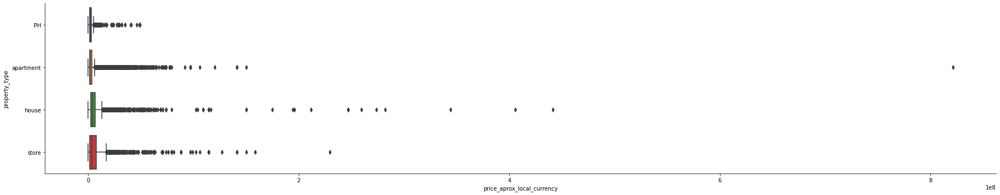

In [7]:
sns.catplot(data=data, x= 'price_aprox_local_currency', y="property_type", kind="box", height=5, aspect=5,)

### Conclusión `price_aprox_local_currency`:
Aunque aplicando regex logramos rellenar algunos datos, no podemos tomar el dato porque nos está trayendo valores errados como propiedades con precios de $1 y tambien porque existen $ para valorar otros campos. Por esta razón no vamos a emplearlo.

Finalmente,hemos decidido eliminar esta columna, teniendo en cuenta que el calculo por metro cuadrado esta hecho en dolares y al observar el numero de nans en esta variable que corresponde al mismo numero de nans en en Price aprox U$d no nos es de utilidad mantenerla para calcular el segundo valor.

## 14. COLUMNA PRICE APROX USD

In [8]:
# Columna price_aprox_usd: revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.price_aprox_usd.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.price_aprox_usd.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['price_aprox_usd']).size().reset_index(name='count'))

Cantidad de registros con NaN: 20410
Porcentaje de registros con NaN: 16.837155584886982
Contamos cantidad de registros unicos:
       price_aprox_usd  count
0                 0.00      1
1              4666.62      1
2              4952.45      1
3              5000.00      2
4              5047.53      5
...                ...    ...
10359      16000000.00      1
10360      19500000.00      1
10361      22980378.29      1
10362      25000000.00      1
10363      46545445.00      1

[10364 rows x 2 columns]


<AxesSubplot:xlabel='property_type'>

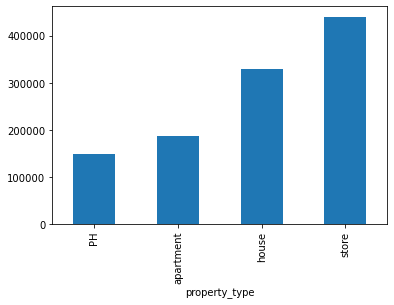

In [9]:
#graficamos el dato por tipo de propiedad con el fin de observar los rangos de precios. En esta grafica podemos observar la variación en la media de los precios que existe de acuerdo al tipo de vivienda.
data.groupby('property_type')['price_aprox_usd'].mean().plot.bar()

In [10]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos 
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos con 
# un apartamento ubicado en la latitul -34.62 y lon -58.37 con un precio de 46 millones de dolares (corresponde a un apartamento ubicado en San Telmo con una superficie total de 200.000 m2 
import plotly.express as px
fig = px.scatter_3d(data, x='lat', y='lon', z='price_aprox_usd',
                    color='property_type')
fig.show()

In [11]:
data.price_aprox_usd.describe()

count    1.008100e+05
mean     2.397006e+05
std      3.913239e+05
min      0.000000e+00
25%      8.973388e+04
50%      1.450000e+05
75%      2.650000e+05
max      4.654544e+07
Name: price_aprox_usd, dtype: float64

## Detalle de análisis de columna `price_aprox_usd`:

* `price_aprox_usd` -> Esta columna tiene 20.410 datos nulos o su equivalente 16,83%. Consideramos que esta variable es relevante para la proyección, teniendo en cuenta que el valor por metro cuadrado cubierto y total estan calculados en esta moneda, observamos un valor máximo de 46,545,445 alejado significativamente de la media que es de 239,700.
Esta columna podriamos completarla realizando diferentes operaciones:
 
1. Extrayendo este dato de las columnas description y title
2. Diviendo el precio total en usd por el precio del metro cuadrado

### Detalle de valores extremos en la  columna `price_aprox_usd`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar como en apartamentos se evidencias valores muy por encima de los valores medios, en el caso de las casas se observan algunas propiedades alejadas de la media.

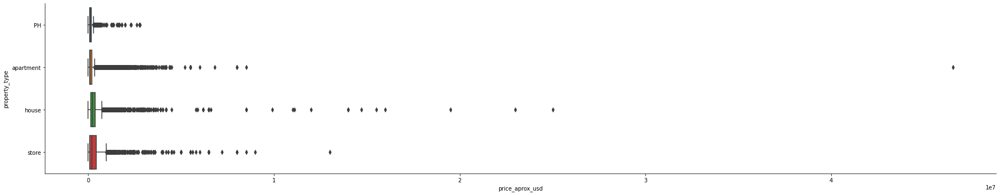

In [12]:
sns.catplot(data=data, x= 'price_aprox_usd', y="property_type", kind="box", height=5, aspect=5,)

### Conclusión `price_aprox_usd`:

Aunque aplicando regex logramos rellenar algunos datos, no podemos tomar el dato porque nos está trayendo valores errados como propiedades con precios de U$1 y tambien porque existen U$ para valorar otros campos. Por esta razón no vamos a emplearlo.

Esta columna se mantiene y se calculara el valor tomando la superficie total y el price-usd_per_m2

## 15. COLUMNA SURFACE TOTAL IN M2

In [13]:
# Columna surface_total_in_m2: revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.surface_total_in_m2.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.surface_total_in_m2.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['surface_total_in_m2']).size().reset_index(name='count'))

Cantidad de registros con NaN: 39328
Porcentaje de registros con NaN: 32.44349117307375
Contamos cantidad de registros unicos:
      surface_total_in_m2  count
0                     0.0    383
1                    10.0     21
2                    11.0      8
3                    12.0     12
4                    13.0      6
...                   ...    ...
1682             100350.0      1
1683             107000.0      4
1684             110000.0      3
1685             154438.0      1
1686             200000.0      2

[1687 rows x 2 columns]


<AxesSubplot:xlabel='state_name'>

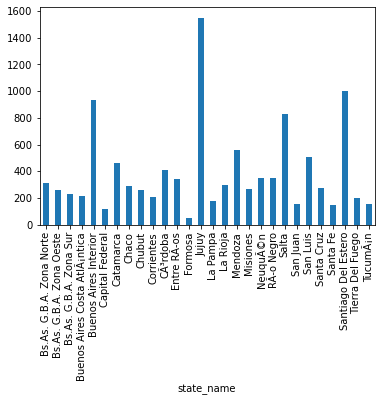

In [14]:
#graficamos el dato por estado con el fin de observar los rangos de areas de superficie total.
#En esta grafica podemos observar la variación en la media de las areas que existen de acuerdo al Estado, se observa como en Juluy el valor medio se eleva, deberia revisarse si corresponde al valor extremo de alguna o algunas propiedades.
data.groupby('state_name')['surface_total_in_m2'].mean().plot.bar()

In [15]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos  de 200.000 m2 de superficie total
# dos apartamentos ubicados en Santa Fe y Santelmo con un area de 200.000 m2 con lat lon de -31.6400864,-60.7046147 y -34.6213421,-58.3741846

import plotly.express as px
fig = px.scatter_3d(data, x='lat', y='lon', z='surface_total_in_m2',
                    color='property_type')
fig.show()

In [16]:
data.surface_total_in_m2.describe()

count     81892.000000
mean        233.795328
std        1782.222147
min           0.000000
25%          50.000000
50%          84.000000
75%         200.000000
max      200000.000000
Name: surface_total_in_m2, dtype: float64

# Detalle de análisis de columnas:
* `surface_total_in_m2 ` -> Esta columna tiene 39.328 datos nulos o su equivalente 32,44%. El precio aprox en U$D se calcula sobre esta superficie, por esta razón se considera un dato relevante. Tiene un valor minimo de cero y un maximo de 200.000, datos que se alejan de la media de 233 m2.
Podemos completar algunos de los datos extrayendolos de las columnas title y description
Si se completan las columnas Precio aprox en U$D y Precio en U$d por metro cuadrado puede realizarse un calculo de ete valor.

### Detalle de valores extremos en la  columna `surface_total_in_m2`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar como en apartamentos se evidencian areas muy por encima de los valores medios, en el caso de las casas se observan algunas propiedades alejadas de la media.

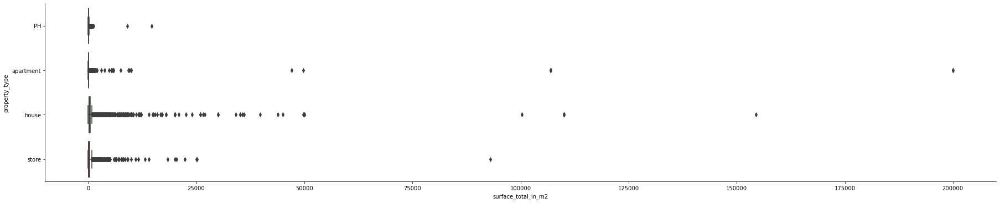

In [17]:
sns.catplot(data=data, x= 'surface_total_in_m2', y="property_type", kind="box", height=5, aspect=5,)

### Regex para rellenar la columna `surface_total_in_m2`:

Vamos a extraer datos de las columnas title y description para extraer esta información, para ello utilizaremos las expresiones de numeros que vengan acompañados del texto m2, M2, metros2, Metros2, mts2 y Mts2, no se consideran los datos separados del número 2 porque se podría incurrir en el error de que haya un dato con el valor M y luego figure el número 2 correspondiente a otras variables.

In [18]:
# Buscamos superficie total en metros cuadrado en los titulos y en la descripción con Mts2

#el area más pequeña es de 0 m2 hay 383 registos en ceros, trae a la base m2, debemos eliminarlos y transformar . a , ???

data[['description', 'title']] = data[['description', 'title']].apply(lambda x: x.astype(str))

patron = r'([0-9]*\.?\,?[0-9]*)\s?[m|M|mts|Mts|metros|Metros|METROS]\.?\S*2'
    
regex = re.compile(patron, flags = re.IGNORECASE)

superficie_total_titulo=data['title'].replace(np.NAN,"").apply(lambda x: regex.findall(x)[0] if regex.findall(x) else np.NaN)
data['surface_total_in_m2'].fillna(superficie_total_titulo, inplace=True)

superficie_total_descripcion=data['description'].replace(np.NAN,"").apply(lambda x: regex.findall(x)[0] if regex.findall(x) else np.NaN)
data['surface_total_in_m2'].fillna(superficie_total_descripcion, inplace=True)

In [19]:
#luego de aplicar el regex se logran recucir el porcentaje de nans al pasar del 32.44% al 23.52%.
print (f'% de valores nulos que quedan luego de aplicar regex: {data.surface_total_in_m2.isna().sum()/data.surface_total_in_m2.shape[0]*100}')
print (f'entradas: {data.surface_total_in_m2.shape[0]}')

% de valores nulos que quedan luego de aplicar regex: 23.52829566078205
entradas: 121220


In [20]:
#Vamos a transformar los datos de la columna ya que al extraer datos de regex se convirtieron en tipo object
data['surface_total_in_m2'] = pd.to_numeric(data['surface_total_in_m2'],errors = 'coerce')

In [21]:
#luego de transformar los datos a datos numericos con pandas el porcentaje de nans se reduce finalmente del 32.44% al 25.67%. 
#estos valores se mantendran y se emplearan para el calculo del price_aprox_usd, junto con el valor de price_usd_per m2

print (f'% de valores nulos que quedan luego de aplicar regex: {data.surface_total_in_m2.isna().sum()/data.surface_total_in_m2.shape[0]*100}')
print (f'entradas: {data.surface_total_in_m2.shape[0]}')

% de valores nulos que quedan luego de aplicar regex: 25.678105923114998
entradas: 121220


### Conclusión `surface_total_in_m2`:

Luego de emplear rejex y transformar los datos a datos numericos con pandas el porcentaje de nans se reduce finalmente del 32.44% al 25.67%. 
#estos valores se mantendran y se emplearan para el calculo del price_aprox_usd, junto con el valor de price_usd_per m2

## 16. COLUMNA SURFACE COVERED IN M2

In [22]:
# Columna surface_covered_in_m2: revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.surface_covered_in_m2.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.surface_covered_in_m2.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['surface_covered_in_m2']).size().reset_index(name='count'))

Cantidad de registros con NaN: 19907
Porcentaje de registros con NaN: 16.422207556508827
Contamos cantidad de registros unicos:
     surface_covered_in_m2  count
0                      0.0      2
1                      1.0    367
2                      2.0     12
3                      3.0      7
4                      4.0     10
..                     ...    ...
990                30000.0      1
991                35000.0      1
992                38240.0      1
993                49000.0      1
994               187000.0      1

[995 rows x 2 columns]


<AxesSubplot:xlabel='state_name'>

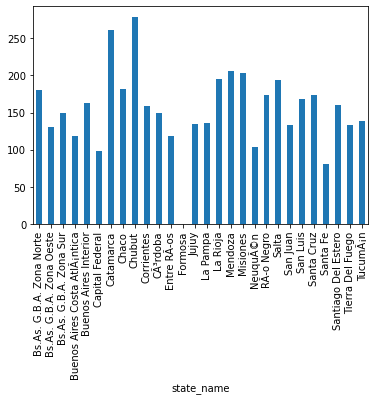

In [23]:
#graficamos el dato por Estado con el fin de observar los rangos de areas de superficie cubierta. Se observa como en los etados de Catamarca y de Chubut las areas exceden el promedio de los demás estados.
data.groupby('state_name')['surface_covered_in_m2'].mean().plot.bar()

In [24]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos con 
# un apartamento ubicado en la latitul -34.59457 y lon -58.40917 con un area cubierta de 187.000m2 que resulta ser un error de digitación,
# ya que al revisar en la descripción se aclara que es un apartamento de 187m2 
# Tambien encontramos una casa con valor de 0 en lat -4.54 y lon de -75.67
import plotly.express as px
fig = px.scatter_3d(data, x='lat', y='lon', z='surface_covered_in_m2',
                    color='property_type')
fig.show()

In [25]:
#podemos corregir el valor de ese dato para lo cual primero vamos a localizarlo
data[data.surface_covered_in_m2==187000]

,Unnamed: 0,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat-lon,lat,...,surface_covered_in_m2,price_usd_per_m2,price_per_m2,floor,rooms,expenses,properati_url,description,title,image_thumbnail
76012,76012,sell,apartment,Barrio Norte,|Argentina|Capital Federal|Barrio Norte|,Argentina,Capital Federal,3436109.0,"-34.5945726028,-58.409166395",-34.594573,...,187000.0,NaN,3.208556,NaN,NaN,11000.0,http://www.properati.com.ar/1ar12_venta_depart...,Barrio Norte EXCELENTE Semipiso al Frente Balc...,Excelente PISO en Barrio Norte,https://thumbs4.properati.com/0/Z9TPL-aDoGIWcI...


In [26]:
#Ahora vamos a corregir el dato con at
data.at['76012','surface_covered_in_m2']=187

# Detalle de análisis de columnas:
* `surface_covered_in_m2 ` -> Esta columna tiene 19.907 datos nulos o su equivalente 16,42%. Esta variable se emplea para calcular el precio por m2, tomando como base el precio aprox en U$D asi que es una columna relevante. Tiene un valor máximo de 187.000 metros cuadrados valor que se aleja de la media de 133 metros cuadrados.

Esta columna podriamos completarla extrayendo datos de las columnas title y description, tambien calculando el valor tomando el precio en USD y el valor del metro cuadrado 

### Detalle de valores extremos en la  columna `surface_covered_in_m2`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar especialmente el area de un apartamento cuya area sobrepasa los 180.000 metros cuadrados.

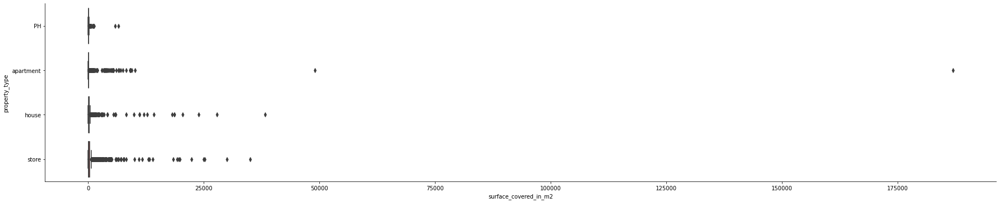

In [27]:
sns.catplot(data=data, x= 'surface_covered_in_m2', y="property_type", kind="box", height=5, aspect=5,)

### Regex para rellenar la columna `surface_covered_in_m2`:

Vamos a extraer datos de las columnas title y description para extraer esta información, para ello tomaremos las diferentes denominaciónes de metros cuadrados: (m,M,mts, Mts, metros, Metros, METROS), tambien se emplean las terminaciones despues del número 2 (c,cub,cubiertos)

In [28]:
# Buscamos superficies cubiertas en metros cuadrado en los titulos y en la descripción

#el area más pequeña es de 1 m2, 161 aptos, 146 casas, deberiamos sacar el dato para aquellas que sean null o tengan menos de 10 m2 trae a la base m2, debemos eliminarlos y transformar . a , ???

data[['description', 'title']] = data[['description', 'title']].apply(lambda x: x.astype(str))

patron = r'([0-9]*\.?\,?[0-9]*)\s?[m|M|mts|Mts|metros|Metros|METROS]\.?\S*2\S*[c|cub|cubiertos]'

regex = re.compile(patron, flags = re.IGNORECASE)

superficie_cubierta_titulo=data['title'].replace(np.NAN,"").apply(lambda x: regex.findall(x)[0] if regex.findall(x) else np.NaN)
data['surface_covered_in_m2'].fillna(superficie_cubierta_titulo, inplace=True)

superficie_cubierta_descripcion=data['description'].replace(np.NAN,"").apply(lambda x: regex.findall(x)[0] if regex.findall(x) else np.NaN)
data['surface_covered_in_m2'].fillna(superficie_cubierta_descripcion, inplace=True)

In [29]:
#luego de aplicar el regex se logran recucir el porcentaje de nans al pasar del 16.42% al 15.80%.
print (f'% de valores nulos que quedan luego de aplicar regex: {data.surface_covered_in_m2.isna().sum()/data.surface_covered_in_m2.shape[0]*100}')
print (f'entradas: {data.surface_covered_in_m2.shape[0]}')

% de valores nulos que quedan luego de aplicar regex: 15.808317040776762
entradas: 121221


In [30]:
#Vamos a transformar los datos de la columna ya que al extraer datos de regex se convirtieron en tipo object
data['surface_covered_in_m2'] = pd.to_numeric(data['surface_covered_in_m2'],errors = 'coerce')

In [31]:
#luego de aplicar el regex y transformar los datos a floats se logran recucir el porcentaje de nans al pasar del 16.42% al 15.80%.
print (f'% de valores nulos que quedan luego de aplicar regex: {data.surface_covered_in_m2.isna().sum()/data.surface_covered_in_m2.shape[0]*100}')
print (f'entradas: {data.surface_covered_in_m2.shape[0]}')

% de valores nulos que quedan luego de aplicar regex: 15.988153867729189
entradas: 121221


### Conclusión `surface_covered_in_m2`:

#luego de aplicar el regex y transformar los datos a floats se logran recucir el porcentaje de nans al pasar del 16.42% al 15.98%.
#estos valores se mantendran y se emplearan para el calculo del price_aprox_usd, junto con el valor de

## 17. PRICE USD PER M2

In [32]:
# Columna price_usd_per_m2 : revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.price_usd_per_m2.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.price_usd_per_m2.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['price_usd_per_m2']).size().reset_index(name='count'))

Cantidad de registros con NaN: 52604
Porcentaje de registros con NaN: 43.395121307364235
Contamos cantidad de registros unicos:
       price_usd_per_m2  count
0              0.600000      1
1              1.000000      1
2              1.184571      1
3              1.236986      1
4              1.573442      1
...                 ...    ...
25562      78533.333333      1
25563      80000.000000      1
25564     104486.114286      1
25565     173826.066667      1
25566     206333.333333      1

[25567 rows x 2 columns]


<AxesSubplot:xlabel='state_name'>

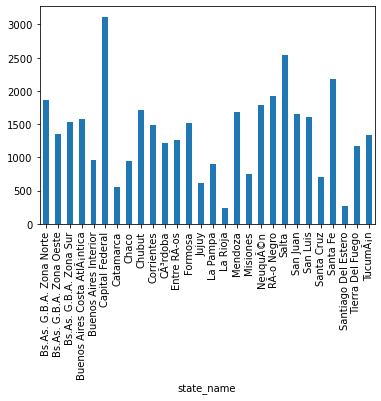

In [33]:
#graficamos el dato por Estado con el fin de observar los rangos de precios en dolares por metro cuadrado
#En esta grafica podemos observar la variación en la media de las areas que existen de acuerdo al Estado.
data.groupby('state_name')['price_usd_per_m2'].mean().plot.bar()

In [36]:
# para graficar vamos a tomar unicamente los datos no nulos de la columna price_usd_per_m2

price_usd_null=data.price_usd_per_m2.isnull()
price_usd_null

0         False
1          True
2         False
3          True
4         False
          ...  
121216    False
121217    False
121218    False
121219    False
76012      True
Name: price_usd_per_m2, Length: 121221, dtype: bool

In [37]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos con 
# un apartamento ubicado en la latitud -34.6222 y lon -58.41609 con un valor  de u$d206.000,
import plotly.express as px
fig = px.scatter_3d(data[~price_usd_null], x='lat', y='lon', z='price_usd_per_m2',
                    color='property_type')
fig.show()

In [ ]:
data.price_usd_per_m2.describe()

Detalle de análisis de columnas:
* `price_usd_per_m2` -> Esta columna tiene 52.603 datos nulos o su equivalente 43.39%. Consideramos que esta variable es relevante para la proyección, por esta razón consideramos que podriamos completarla realizando diferentes operaciones:
1. Rellenando el valor de la columna con la mediana de los precios por metro por place name

Empleamos la mediana para que los datos no se vean afectados por los valores extremos.

### Detalle de valores extremos en la  columna `price_usd_per_m2`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar 6 datos que se alejan significativamente de la media principalmente en el tipo de propiedad apartamentos.

In [ ]:
sns.catplot(data=data, x= 'price_usd_per_m2', y="property_type", kind="box", height=5, aspect=5,)


### Completar la columna `price_usd_per_m2` con la mediana por place name:

Hemos decidido emplear la mediana teniendo en cuenta que en los datos se encuentran valores extremos significativos que podrian afectar la proyección de los datos.

In [ ]:

#vamos a extraer la mediana de el precio por m2 en dolares por place name

mediana_precio_usd_place_name = data.groupby('place_name').price_usd_per_m2.median()

mediana_precio_usd_place_name.head()

In [ ]:
print(type(mediana_precio_usd_place_name))

In [ ]:
mediana_precio_usd_place_name.index

In [ ]:
mediana_precio_usd_place_name.values

In [ ]:
#vamos a construir un dataframe con las columnas place_name y price_usd_per_m2

mediana_precio_usd_place_name_df = pd.DataFrame(mediana_precio_usd_place_name)

mediana_precio_usd_place_name_df.head(5)

In [ ]:
#vamos a resetear el indice para que place_name se convierta en columna

mediana_precio_usd_place_name_df.reset_index(inplace=True)
mediana_precio_usd_place_name_df.head(5)

In [ ]:
#vamos a crear una columna con los valores de la mediana del precio por m2 en usd para cada place_name
data = data.merge(mediana_precio_usd_place_name_df, on = "place_name", suffixes = ("", "_median"), how = 'left')
data.head(5)

In [ ]:
#vamos a cambiar los nan de la columna price_usd_per_m2 por la mediana calculada para cada place_name

data.price_usd_per_m2.fillna(data.price_usd_per_m2_median, inplace = True)

data.head(5)


In [ ]:
#luego de reemplazar los valores por la mediana por place name se logran recucir el porcentaje de nans al pasar del 43.39% al 1.26%.
print (f'% de valores nulos que quedan luego de remplazar por la mediana por place_name: {data.price_usd_per_m2.isna().sum()/data.price_usd_per_m2.shape[0]*100}')
print (f'entradas: {data.price_usd_per_m2.shape[0]}')

## 18. PRICE PER M2

In [ ]:
# Columna price_per_m2 : revisamos que opciones tiene, o si se repite lo mismo.
print(f'Cantidad de registros con NaN: {data.price_per_m2.isnull().sum()}')
print(f'Porcentaje de registros con NaN: {data.price_per_m2.isnull().mean()*100}')
print("Contamos cantidad de registros unicos:")
print(data.groupby(['price_per_m2']).size().reset_index(name='count'))

In [ ]:
#graficamos el dato por Estado con el fin de observar los rangos de precios por metro cuadrado
#En esta grafica podemos observar la variación en la media de las areas que existen de acuerdo al Estado.
data.groupby('state_name')['price_per_m2'].mean().plot.bar()

In [38]:

price_null=data.price_per_m2.isnull()
price_null

0         False
1          True
2         False
3          True
4         False
          ...  
121216    False
121217    False
121218    False
121219    False
76012      True
Name: price_per_m2, Length: 121221, dtype: bool

In [39]:
# Al visualizar esta grafica podemos observar como en esta columna existen valores extremos y al revisar los datos vemos que son errores
#en algunos casos los valores de metros cuadrados son los mismos valores_aprox en dolares o pesos.

import plotly.express as px
fig = px.scatter_3d(data[~price_usd_null], x='lat', y='lon', z='price_per_m2',
                    color='property_type')
fig.show()

In [ ]:
#vamos a identificar los casos para poder corregirlos o eliminarlos de acuerdo con la observación.
# En algunos casos los valores por metro cuadrado son los mismos precios aprox en u$d o en $, lo que evidencia un error en el dato.
#Hay 41 registros que tienen valores suoperiores a u$d400.000 por metro cuadrado cubierto

#####  Qué hacemos con estos registros?????#######

data[data.price_per_m2>=400000]

In [ ]:
data.price_per_m2.describe()

Detalle de análisis de columnas:
* `price_per_m2` -> Esta columna tiene 33.562 datos nulos o su equivalente 27.68%. Consideramos que esta variable es relevante para la proyección, y podriamos completarla realizando diferentes operaciones:
Los datos tienen un valor máximo de 3,999,999 dolares por metro cuadrado, frente a una media de 6,912 dolares por metro cuadrado.

1. calculando la mediana del valor m2 cubierto de acuerdo con el place name

### Detalle de valores extremos en la  columna `price_per_m2`:

En el catplot elaborado para esta variable comparada por tipo de propiedad podemos observar 10 datos que se alejan significativamente de la media principalmente en el tipo de propiedad apartamentos.

In [ ]:
sns.catplot(data=data, x= 'price_per_m2', y="property_type", kind="box", height=5, aspect=5,)


### Completar la columna `price_per_m2` con la mediana por place name:

Hemos decidido emplear la mediana teniendo en cuenta que en los datos se encuentran valores extremos significativos que podrian afectar la proyección de los datos.

In [ ]:
#vamos a extraer la mediana de el precio por m2 por place name

mediana_precio_place_name = data.groupby('place_name').price_per_m2.median()

mediana_precio_place_name.head()

In [ ]:
print(type(mediana_precio_place_name))

In [ ]:
mediana_precio_place_name.index

In [ ]:
mediana_precio_place_name.values

In [ ]:
#vamos a construir un dataframe con las columnas place_name y price_per_m2

mediana_precio_place_name_df = pd.DataFrame(mediana_precio_place_name)

mediana_precio_place_name_df.head(5)

In [ ]:
#vamos a resetear el indice para que place_name se convierta en columna

mediana_precio_place_name_df.reset_index(inplace=True)
mediana_precio_place_name_df.head(5)

In [ ]:
#vamos a crear una columna con los valores de la mediana del precio por m2 para cada place_name
data = data.merge(mediana_precio_place_name_df, on = "place_name", suffixes = ("", "_median"), how = 'left')
data.head(5)

In [ ]:
#vamos a reemplazar los nan de la columna price_per_m2 por la mediana calculada para cada place_name

data.price_per_m2.fillna(data.price_per_m2_median, inplace = True)

data.head(5)

In [ ]:
#luego de reemplazar los valores por la mediana por place name se logran reducir el porcentaje de nans al pasar del 43.39% al 0.3283%.
print (f'% de valores nulos que quedan luego de remplazar por la mediana por place_name: {data.price_per_m2.isna().sum()/data.price_per_m2.shape[0]*100}')
print (f'entradas: {data.price_per_m2.shape[0]}')

# RELLENAR DATOS POR COLUMNAS

# LIMPIEZA DE DATOS

# ELIMINAR FILAS CON BAJO PORCENTAJE DE DATOS NULOS
Vamos eliminar filas que tienen muy pocos nans como es el caso de description que tiene 0.001650

In [ ]:
#este seria el código
# data.dropna(inplace=True, subset=['description'])

# ELIMINAR COLUMNAS INNECESARIAS
Estas columnas no se considera aporten a la prediccion de precios o tienen el mismo dato en todas la filas



In [ ]:
#columnas = ['operation','country_name','expenses', 'properati_url', 'image_thumbnail','floor']
#data.drop(columnas, axis=1, inplace=True)
#data.head()

# ELIMINAR DUPLICADOS QUE TIENEN LOS MISMOS DATOS EN TODAS LAS COLUMNAS
Estas son propiedades que tienen la misma información en todas las columnas y se mantendrá solamente el dato del último registro

# ELIMINAR DUPLICADOS QUE TIENEN LOS MISMOS DATOS EN ALGUNAS COLUMNAS
Vamos eliminar duplicados por que se repiten los datos en algunas columnas





In [ ]:
#Este sería el código para identificar duplicados

#mask_duplicados=data.duplicated(['title', 'description', 'surface_total_in_m2', 'surface_covered_in_m2'])
#data_duplicados= data[mask_duplicados].sort_values(['title']) 
#data_duplicados.head()
#data_duplicados.shape


In [ ]:
#Este sería el código para eliminarlos

#data_ajustado= data.drop_duplicates(['title', 'description', 'surface_total_in_m2', 'surface_covered_in_m2'],keep='last', inplace=True )

print('las dimensiones de la base que quedan despues de eliminar duplicados', data.shape)